## Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---
## First, I'll compute the camera calibration using chessboard images

In [1]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
%matplotlib qt

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('./camera_cal/calibration*.jpg')

# Step through the list and search for chessboard corners
for fname in images:
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6),None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        img = cv2.drawChessboardCorners(img, (9,6), corners, ret)
        cv2.imshow('img',img)
        cv2.waitKey(500)

cv2.destroyAllWindows()

## And so on and so forth...

In [2]:
def cal_undistort(img, objpoints, imgpoints):
    # Use cv2.calibrateCamera() and cv2.undistort()
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    # undist = np.copy(img)  # Delete this line
    return undist

In [3]:
def warp(img, src, dst):
    
    img_size = (img.shape[1], img.shape[0])
    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    return warped

In [4]:
# Define a function that takes an image, number of x and y points, 
# camera matrix and distortion coefficients
def img_unwarp(img, src, dst):
    # Convert undistorted image to grayscale
    # Grab the image shape
    img_size = (img.shape[1], img.shape[0])
    
    M = cv2.getPerspectiveTransform(src,dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    warped = cv2.warpPerspective(img, M, (img_size[0], img_size[1]))

    # Return the resulting image and matrix
    return warped, M, Minv

In [5]:
def gray_thresh(img, thresh=(0, 255)):
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    binary_output = np.zeros_like(gray)
    binary_output[(gray > thresh[0]) & (gray <= thresh[1])] = 1
    return binary_output

In [6]:
def hls_select(img, thresh=(0, 255)):
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    s_channel = hls[:,:,2]
    binary_output = np.zeros_like(s_channel)
    binary_output[(s_channel > thresh[0]) & (s_channel <= thresh[1])] = 1
    return binary_output

In [7]:
# Define a function that takes an image, gradient orientation,
# and threshold min / max values.
def abs_sobel_thresh(img, orient='x', sobel_kernel=3, thresh=(0, 255)):
    # Convert to grayscale
    gray = img
#     gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Apply x or y gradient with the OpenCV Sobel() function
    # and take the absolute value
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel))
    # Rescale back to 8 bit integer
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # Create a copy and apply the threshold
    binary_output = np.zeros_like(scaled_sobel)
    # Here I'm using inclusive (>=, <=) thresholds, but exclusive is ok too
    binary_output[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1

    # Return the result
    return binary_output

In [8]:
# Define a function to return the magnitude of the gradient
# for a given sobel kernel size and threshold values
def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):
    # Convert to grayscale
    gray = img
#     gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Take both Sobel x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Calculate the gradient magnitude
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    # Rescale to 8 bit
    scale_factor = np.max(gradmag)/255 
    gradmag = (gradmag/scale_factor).astype(np.uint8) 
    # Create a binary image of ones where threshold is met, zeros otherwise
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1

    # Return the binary image
    return binary_output

In [9]:
# Define a function to threshold an image for a given range and Sobel kernel
def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    # Grayscale
    gray = img
#     gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Calculate the x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Take the absolute value of the gradient direction, 
    # apply a threshold, and create a binary image result
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    binary_output =  np.zeros_like(absgraddir)
    binary_output[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1

    # Return the binary image
    return binary_output

In [10]:
# Edit this function to create your own pipeline.
def pipeline(img):
    ksize = 31 # Choose a larger odd number to smooth gradient measurements

    undistorted = cal_undistort(img, objpoints, imgpoints)
    # Apply each of the thresholding functions
    s_binary = hls_select(undistorted, thresh=(80, 255))
    gradx = abs_sobel_thresh(s_binary, orient='x', sobel_kernel=ksize, thresh=(20, 255))
    grady = abs_sobel_thresh(s_binary, orient='y', sobel_kernel=ksize, thresh=(20, 255))
    mag_binary = mag_thresh(s_binary, sobel_kernel=ksize, mag_thresh=(20, 255))
    dir_binary = dir_threshold(s_binary, sobel_kernel=ksize, thresh=(0.7, 1.2))
    combined = np.zeros_like(dir_binary)
    combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1
    
    img_size = (combined.shape[1], combined.shape[0])
    
    offset = 200
#     src = np.float32([
#         [  620, 452 ],
#         [  712, 452 ],
#         [ 1106, 705 ],
#         [  262, 705 ]])
#     dst = np.float32([[offset, 0], [img_size[0] - offset, 0], [img_size[0] - offset, img_size[1]], [offset, img_size[1]]])
    
    
    src = np.float32(
        [[(img_size[0] / 2) - 55, img_size[1] / 2 + 100],
        [((img_size[0] / 6) - 10), img_size[1]],
        [(img_size[0] * 5 / 6) + 60, img_size[1]],
        [(img_size[0] / 2 + 55), img_size[1] / 2 + 100]])
    dst = np.float32(
        [[(img_size[0] / 4), 0],
        [(img_size[0] / 4), img_size[1]],
        [(img_size[0] * 3 / 4), img_size[1]],
        [(img_size[0] * 3 / 4), 0]])
    
    
    
    binary_warped, M, Minv = img_unwarp(img, src, dst)
    
    plt.figure(figsize=(10,40))
    plt.subplot(1,2,1)
    plt.imshow(combined, cmap='gray')
    plt.title('Thresholded Binary')

    plt.subplot(1,2,2)
    binary_warped = cv2.warpPerspective(combined, M, (img_size[0], img_size[1]))
    plt.imshow(binary_warped, cmap='gray')
    plt.title('Binary Warped Image')
    
    
    return undistorted, binary_warped, Minv

In [11]:
def find_lines(binary_warped):
    # Assuming you have created a warped binary image called "binary_warped"
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 20
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),
        (0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),
        (0,255,0), 2) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
    plt.figure(figsize=(10,40))
    plt.imshow(out_img)
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')
    plt.xlim(0, 1280)
    plt.ylim(720, 0)
    
    ym_per_pix = 3.0/72.0 # meters per pixel in y dimension
    xm_per_pix = 3.7/660.0 # meters per pixel in x dimension
    y_eval = 700
    midx = 650

    y1 = (2*left_fit[0]*y_eval + left_fit[1])*xm_per_pix/ym_per_pix
    y2 = 2*left_fit[0]*xm_per_pix/(ym_per_pix*ym_per_pix)

    curvature = ((1 + y1*y1)**(1.5))/np.absolute(y2)
    print("Radius of Curvature: %f" % curvature)
    
    return left_fit, right_fit, curvature

In [12]:
def draw_lanes(undistorted, binary_warped, Minv, left_fit, right_fit, curvature):
    
    ym_per_pix = 3.0/72.0 # meters per pixel in y dimension
    xm_per_pix = 3.7/660.0 # meters per pixel in x dimension
    y_eval = 700
    midx = 650
    
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    newwarp = cv2.warpPerspective(color_warp, Minv, (undistorted.shape[1], undistorted.shape[0])) 

    # Combine the result with the original image
    result = cv2.addWeighted(undistorted, 1, newwarp, 0.3, 0)

    cv2.putText(result,'Radius of Curvature: %.2fm' % curvature,(20,40), cv2.FONT_HERSHEY_SIMPLEX, 1,(255,255,255),2)

    x_left_pix = left_fit[0]*(y_eval**2) + left_fit[1]*y_eval + left_fit[2]
    x_right_pix = right_fit[0]*(y_eval**2) + right_fit[1]*y_eval + right_fit[2]
    position_from_center = ((x_left_pix + x_right_pix)/2 - midx) * xm_per_pix
    if position_from_center < 0:
        text = 'left'
    else:
        text = 'right'
    cv2.putText(result,'Distance From Center: %.2fm %s' % (np.absolute(position_from_center), text),(20,80), cv2.FONT_HERSHEY_SIMPLEX, 1,(255,255,255),2)
#     plt.figure(figsize=(10,40))
#     plt.imshow(result)
    return result

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 689081.242202


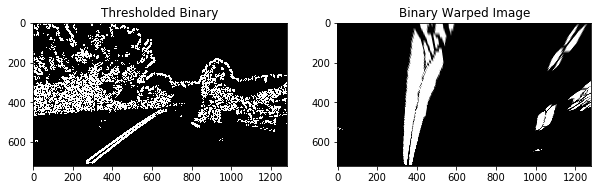

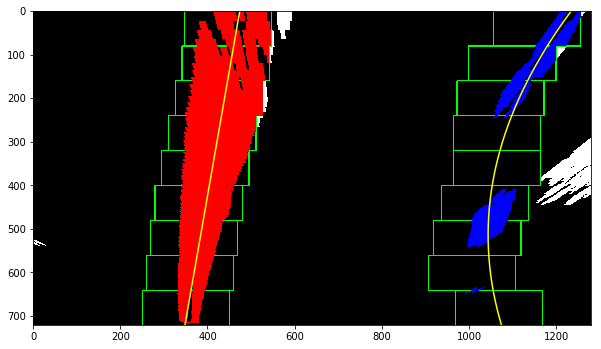

In [13]:
img = cv2.imread('./test_images/test6.jpg')
undistorted, binary_warped, Minv = pipeline(img)
left_fit, right_fit, curvature = find_lines(binary_warped)
result = draw_lanes(undistorted, binary_warped, Minv, left_fit, right_fit, curvature)

In [110]:
# Define a class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False  
        # x values of the last n fits of the line
        self.recent_xfitted = [] 
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent fit
        self.current_fit = [np.array([False])]  
        #radius of curvature of the line in some units
        self.radius_of_curvature = None 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 
        #x values for detected line pixels
        self.allx = None  
        #y values for detected line pixels
        self.ally = None
        
    def update(self, fit):
        if self.detected:
            self.diffs = self.current_fit - fit
        else:
            self.detected = True
            self.current_fit = fit
            self.recent_xfitted.append(fit)
            

In [111]:
def video_pipeline(img):
    undistorted, binary_warped, Minv = pipeline(img)
    left_fit, right_fit, curvature = find_lines(binary_warped)
    line_left.update(left_fit)
    line_right.update(right_fit)
    result = draw_lanes(undistorted, binary_warped, Minv, left_fit, right_fit, curvature)
    return result

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 652.739738
[MoviePy] >>>> Building video project_video_output.mp4
[MoviePy] Writing video project_video_output.mp4



  0%|                                                                                         | 0/1261 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 652.739738



  0%|                                                                                 | 1/1261 [00:01<31:11,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 627.333281



  0%|▏                                                                                | 2/1261 [00:03<32:27,  1.55s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 609.833021



  0%|▏                                                                                | 3/1261 [00:04<31:23,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 645.896341



  0%|▎                                                                                | 4/1261 [00:05<30:41,  1.47s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 624.764910



  0%|▎                                                                                | 5/1261 [00:07<30:13,  1.44s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 608.656836



  0%|▍                                                                                | 6/1261 [00:08<29:56,  1.43s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 628.623118



  1%|▍                                                                                | 7/1261 [00:09<29:41,  1.42s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 655.931142



  1%|▌                                                                                | 8/1261 [00:11<29:32,  1.41s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 674.138570



  1%|▌                                                                                | 9/1261 [00:12<29:25,  1.41s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 662.234206



  1%|▋                                                                               | 10/1261 [00:14<29:20,  1.41s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 709.411318



  1%|▋                                                                               | 11/1261 [00:15<29:14,  1.40s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 707.276931



  1%|▊                                                                               | 12/1261 [00:16<29:09,  1.40s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 797.732949



  1%|▊                                                                               | 13/1261 [00:18<29:06,  1.40s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 907.107813



  1%|▉                                                                               | 14/1261 [00:19<29:07,  1.40s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 868.999020



  1%|▉                                                                               | 15/1261 [00:20<29:02,  1.40s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 918.524699



  1%|█                                                                               | 16/1261 [00:22<28:56,  1.39s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 904.466407



  1%|█                                                                               | 17/1261 [00:23<28:52,  1.39s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 747.579427



  1%|█▏                                                                              | 18/1261 [00:25<28:52,  1.39s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 821.849336



  2%|█▏                                                                              | 19/1261 [00:26<28:51,  1.39s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 911.783373



  2%|█▎                                                                              | 20/1261 [00:27<28:48,  1.39s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 928.689164



  2%|█▎                                                                              | 21/1261 [00:29<28:45,  1.39s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 973.300274



  2%|█▍                                                                              | 22/1261 [00:30<28:42,  1.39s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 844.601479



  2%|█▍                                                                              | 23/1261 [00:31<28:39,  1.39s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 899.947536



  2%|█▌                                                                              | 24/1261 [00:33<28:37,  1.39s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 858.701786



  2%|█▌                                                                              | 25/1261 [00:34<28:35,  1.39s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 816.418753



  2%|█▋                                                                              | 26/1261 [00:36<28:32,  1.39s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 817.313143



  2%|█▋                                                                              | 27/1261 [00:37<28:31,  1.39s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 864.041264



  2%|█▊                                                                              | 28/1261 [00:38<28:29,  1.39s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 708.499213



  2%|█▊                                                                              | 29/1261 [00:40<28:26,  1.39s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 684.419228



  2%|█▉                                                                              | 30/1261 [00:41<28:23,  1.38s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 634.167066



  2%|█▉                                                                              | 31/1261 [00:42<28:25,  1.39s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 593.653359



  3%|██                                                                              | 32/1261 [00:44<28:23,  1.39s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 583.560491



  3%|██                                                                              | 33/1261 [00:45<28:21,  1.39s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 574.689876



  3%|██▏                                                                             | 34/1261 [00:47<28:19,  1.38s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 565.023203



  3%|██▏                                                                             | 35/1261 [00:48<28:19,  1.39s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 534.443881



  3%|██▎                                                                             | 36/1261 [00:49<28:17,  1.39s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 489.184942



  3%|██▎                                                                             | 37/1261 [00:51<28:15,  1.39s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 494.448934



  3%|██▍                                                                             | 38/1261 [00:52<28:13,  1.39s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 450.143277



  3%|██▍                                                                             | 39/1261 [00:53<28:11,  1.38s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 463.622168



  3%|██▌                                                                             | 40/1261 [00:55<28:10,  1.38s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 486.479499



  3%|██▌                                                                             | 41/1261 [00:56<28:08,  1.38s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 475.755982



  3%|██▋                                                                             | 42/1261 [00:58<28:07,  1.38s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 471.740106



  3%|██▋                                                                             | 43/1261 [00:59<28:06,  1.38s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 489.160978



  3%|██▊                                                                             | 44/1261 [01:00<28:04,  1.38s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 539.843869



  4%|██▊                                                                             | 45/1261 [01:02<28:02,  1.38s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 578.266289



  4%|██▉                                                                             | 46/1261 [01:03<28:00,  1.38s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 609.418423



  4%|██▉                                                                             | 47/1261 [01:05<27:59,  1.38s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 618.951015



  4%|███                                                                             | 48/1261 [01:06<27:58,  1.38s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 710.350178



  4%|███                                                                             | 49/1261 [01:07<27:56,  1.38s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 746.219094



  4%|███▏                                                                            | 50/1261 [01:09<27:55,  1.38s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 766.615092



  4%|███▏                                                                            | 51/1261 [01:10<27:54,  1.38s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 714.986791



  4%|███▎                                                                            | 52/1261 [01:11<27:53,  1.38s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 753.879123



  4%|███▎                                                                            | 53/1261 [01:13<27:52,  1.38s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 677.044356



  4%|███▍                                                                            | 54/1261 [01:14<27:50,  1.38s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 839.244798



  4%|███▍                                                                            | 55/1261 [01:16<27:49,  1.38s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 889.107391



  4%|███▌                                                                            | 56/1261 [01:17<27:53,  1.39s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 934.695232



  5%|███▌                                                                            | 57/1261 [01:19<27:53,  1.39s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 943.338242



  5%|███▋                                                                            | 58/1261 [01:20<27:52,  1.39s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 808.924917



  5%|███▋                                                                            | 59/1261 [01:22<27:52,  1.39s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 846.839020



  5%|███▊                                                                            | 60/1261 [01:23<27:51,  1.39s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 746.257639



  5%|███▊                                                                            | 61/1261 [01:24<27:51,  1.39s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 739.432998



  5%|███▉                                                                            | 62/1261 [01:26<27:50,  1.39s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 712.600576



  5%|███▉                                                                            | 63/1261 [01:27<27:51,  1.40s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 691.944375



  5%|████                                                                            | 64/1261 [01:29<27:52,  1.40s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 681.299469



  5%|████                                                                            | 65/1261 [01:30<27:53,  1.40s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 637.883874



  5%|████▏                                                                           | 66/1261 [01:32<27:53,  1.40s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 675.534331



  5%|████▎                                                                           | 67/1261 [01:33<27:54,  1.40s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 688.828395



  5%|████▎                                                                           | 68/1261 [01:35<27:54,  1.40s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 648.154710



  5%|████▍                                                                           | 69/1261 [01:36<27:53,  1.40s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 670.212144



  6%|████▍                                                                           | 70/1261 [01:38<27:52,  1.40s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 677.857022



  6%|████▌                                                                           | 71/1261 [01:39<27:50,  1.40s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 778.711617



  6%|████▌                                                                           | 72/1261 [01:41<27:48,  1.40s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 812.175135



  6%|████▋                                                                           | 73/1261 [01:42<27:47,  1.40s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 937.276066



  6%|████▋                                                                           | 74/1261 [01:43<27:45,  1.40s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1027.461352



  6%|████▊                                                                           | 75/1261 [01:45<27:44,  1.40s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1257.364419



  6%|████▊                                                                           | 76/1261 [01:46<27:43,  1.40s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1250.045578



  6%|████▉                                                                           | 77/1261 [01:48<27:46,  1.41s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1636.273082



  6%|████▉                                                                           | 78/1261 [01:49<27:47,  1.41s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1505.184790



  6%|█████                                                                           | 79/1261 [01:51<27:48,  1.41s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1727.466114



  6%|█████                                                                           | 80/1261 [01:53<27:48,  1.41s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1366.832295



  6%|█████▏                                                                          | 81/1261 [01:54<27:46,  1.41s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1233.283478



  7%|█████▏                                                                          | 82/1261 [01:55<27:45,  1.41s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1112.723561



  7%|█████▎                                                                          | 83/1261 [01:57<27:43,  1.41s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1175.838824



  7%|█████▎                                                                          | 84/1261 [01:58<27:42,  1.41s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1114.959304



  7%|█████▍                                                                          | 85/1261 [02:00<27:41,  1.41s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 993.978173



  7%|█████▍                                                                          | 86/1261 [02:01<27:42,  1.41s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 917.418038



  7%|█████▌                                                                          | 87/1261 [02:03<27:40,  1.41s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 744.623426



  7%|█████▌                                                                          | 88/1261 [02:04<27:39,  1.42s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 743.702279



  7%|█████▋                                                                          | 89/1261 [02:05<27:38,  1.42s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 656.139735



  7%|█████▋                                                                          | 90/1261 [02:07<27:37,  1.42s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 609.077466



  7%|█████▊                                                                          | 91/1261 [02:08<27:35,  1.42s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 627.275296



  7%|█████▊                                                                          | 92/1261 [02:10<27:35,  1.42s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 569.852981



  7%|█████▉                                                                          | 93/1261 [02:11<27:34,  1.42s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 596.666918



  7%|█████▉                                                                          | 94/1261 [02:13<27:33,  1.42s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 577.609271



  8%|██████                                                                          | 95/1261 [02:14<27:32,  1.42s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 598.062598



  8%|██████                                                                          | 96/1261 [02:16<27:30,  1.42s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 651.812529



  8%|██████▏                                                                         | 97/1261 [02:17<27:29,  1.42s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 684.667134



  8%|██████▏                                                                         | 98/1261 [02:18<27:27,  1.42s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 683.894403



  8%|██████▎                                                                         | 99/1261 [02:20<27:25,  1.42s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 642.653205



  8%|██████▎                                                                        | 100/1261 [02:21<27:24,  1.42s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 667.646900



  8%|██████▎                                                                        | 101/1261 [02:23<27:23,  1.42s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 689.803319



  8%|██████▍                                                                        | 102/1261 [02:24<27:22,  1.42s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 655.502081



  8%|██████▍                                                                        | 103/1261 [02:25<27:21,  1.42s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 649.556028



  8%|██████▌                                                                        | 104/1261 [02:27<27:19,  1.42s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 629.536148



  8%|██████▌                                                                        | 105/1261 [02:28<27:17,  1.42s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 669.233792



  8%|██████▋                                                                        | 106/1261 [02:30<27:16,  1.42s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 675.334264



  8%|██████▋                                                                        | 107/1261 [02:31<27:14,  1.42s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 626.072014



  9%|██████▊                                                                        | 108/1261 [02:33<27:13,  1.42s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 578.628563



  9%|██████▊                                                                        | 109/1261 [02:34<27:12,  1.42s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 595.786668



  9%|██████▉                                                                        | 110/1261 [02:35<27:11,  1.42s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 577.386196



  9%|██████▉                                                                        | 111/1261 [02:37<27:11,  1.42s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 624.001685



  9%|███████                                                                        | 112/1261 [02:39<27:13,  1.42s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 589.110973



  9%|███████                                                                        | 113/1261 [02:40<27:13,  1.42s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 584.632383



  9%|███████▏                                                                       | 114/1261 [02:42<27:13,  1.42s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 556.406758



  9%|███████▏                                                                       | 115/1261 [02:44<27:19,  1.43s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 559.119447



  9%|███████▎                                                                       | 116/1261 [02:46<27:25,  1.44s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 612.447435



  9%|███████▎                                                                       | 117/1261 [02:48<27:29,  1.44s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 587.917611



  9%|███████▍                                                                       | 118/1261 [02:50<27:32,  1.45s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 590.448464



  9%|███████▍                                                                       | 119/1261 [02:52<27:34,  1.45s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 596.058439



 10%|███████▌                                                                       | 120/1261 [02:54<27:35,  1.45s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 556.043309



 10%|███████▌                                                                       | 121/1261 [02:55<27:35,  1.45s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 548.628680



 10%|███████▋                                                                       | 122/1261 [02:57<27:35,  1.45s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 530.920297



 10%|███████▋                                                                       | 123/1261 [02:58<27:34,  1.45s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 560.079273



 10%|███████▊                                                                       | 124/1261 [03:00<27:34,  1.46s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 518.904719



 10%|███████▊                                                                       | 125/1261 [03:01<27:33,  1.46s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 553.166248



 10%|███████▉                                                                       | 126/1261 [03:03<27:32,  1.46s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 601.012508



 10%|███████▉                                                                       | 127/1261 [03:05<27:32,  1.46s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 627.440243



 10%|████████                                                                       | 128/1261 [03:06<27:31,  1.46s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 616.015254



 10%|████████                                                                       | 129/1261 [03:08<27:31,  1.46s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 665.417944



 10%|████████▏                                                                      | 130/1261 [03:09<27:30,  1.46s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 646.943794



 10%|████████▏                                                                      | 131/1261 [03:11<27:30,  1.46s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 672.285758



 10%|████████▎                                                                      | 132/1261 [03:12<27:30,  1.46s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 646.566360



 11%|████████▎                                                                      | 133/1261 [03:14<27:30,  1.46s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 640.011258



 11%|████████▍                                                                      | 134/1261 [03:16<27:30,  1.46s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 705.925631



 11%|████████▍                                                                      | 135/1261 [03:17<27:30,  1.47s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 729.314966



 11%|████████▌                                                                      | 136/1261 [03:19<27:29,  1.47s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 748.478174



 11%|████████▌                                                                      | 137/1261 [03:26<28:12,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 757.867127



 11%|████████▋                                                                      | 138/1261 [03:27<28:12,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 774.727305



 11%|████████▋                                                                      | 139/1261 [03:29<28:10,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 796.011770



 11%|████████▊                                                                      | 140/1261 [03:31<28:10,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 836.523535



 11%|████████▊                                                                      | 141/1261 [03:32<28:10,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 844.934725



 11%|████████▉                                                                      | 142/1261 [03:34<28:10,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 749.536988



 11%|████████▉                                                                      | 143/1261 [03:36<28:10,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 762.861733



 11%|█████████                                                                      | 144/1261 [03:37<28:10,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 715.918925



 11%|█████████                                                                      | 145/1261 [03:39<28:09,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 751.267688



 12%|█████████▏                                                                     | 146/1261 [03:40<28:07,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 802.842861



 12%|█████████▏                                                                     | 147/1261 [03:42<28:05,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 724.567012



 12%|█████████▎                                                                     | 148/1261 [03:43<28:03,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 657.769012



 12%|█████████▎                                                                     | 149/1261 [03:45<28:02,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 744.972145



 12%|█████████▍                                                                     | 150/1261 [03:47<28:01,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 788.322210



 12%|█████████▍                                                                     | 151/1261 [03:48<28:00,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 813.126674



 12%|█████████▌                                                                     | 152/1261 [03:50<28:00,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 737.029166



 12%|█████████▌                                                                     | 153/1261 [03:51<27:58,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 759.014962



 12%|█████████▋                                                                     | 154/1261 [03:53<27:55,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 752.974980



 12%|█████████▋                                                                     | 155/1261 [03:54<27:53,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 716.114433



 12%|█████████▊                                                                     | 156/1261 [03:55<27:50,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 740.127386



 12%|█████████▊                                                                     | 157/1261 [03:57<27:48,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 597.086059



 13%|█████████▉                                                                     | 158/1261 [03:58<27:46,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 640.534849



 13%|█████████▉                                                                     | 159/1261 [04:00<27:44,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 597.115974



 13%|██████████                                                                     | 160/1261 [04:01<27:44,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 683.908186



 13%|██████████                                                                     | 161/1261 [04:03<27:43,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 680.880059



 13%|██████████▏                                                                    | 162/1261 [04:05<27:43,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 718.346890



 13%|██████████▏                                                                    | 163/1261 [04:06<27:42,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 643.870909



 13%|██████████▎                                                                    | 164/1261 [04:08<27:40,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 706.405333



 13%|██████████▎                                                                    | 165/1261 [04:09<27:39,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 699.228059



 13%|██████████▍                                                                    | 166/1261 [04:11<27:38,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 662.492240



 13%|██████████▍                                                                    | 167/1261 [04:12<27:36,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 702.919730



 13%|██████████▌                                                                    | 168/1261 [04:14<27:35,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 649.888189



 13%|██████████▌                                                                    | 169/1261 [04:16<27:35,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 745.177364



 13%|██████████▋                                                                    | 170/1261 [04:17<27:33,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 789.434912



 14%|██████████▋                                                                    | 171/1261 [04:19<27:30,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 748.539438



 14%|██████████▊                                                                    | 172/1261 [04:20<27:28,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 729.287622



 14%|██████████▊                                                                    | 173/1261 [04:21<27:27,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 648.827153



 14%|██████████▉                                                                    | 174/1261 [04:23<27:26,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 634.251142



 14%|██████████▉                                                                    | 175/1261 [04:25<27:24,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 667.502220



 14%|███████████                                                                    | 176/1261 [04:26<27:23,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 747.221145



 14%|███████████                                                                    | 177/1261 [04:28<27:22,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 750.351572



 14%|███████████▏                                                                   | 178/1261 [04:29<27:22,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 742.187232



 14%|███████████▏                                                                   | 179/1261 [04:31<27:22,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 672.609837



 14%|███████████▎                                                                   | 180/1261 [04:38<27:54,  1.55s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 569.390812



 14%|███████████▎                                                                   | 181/1261 [04:40<27:54,  1.55s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 534.813188



 14%|███████████▍                                                                   | 182/1261 [04:42<27:53,  1.55s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 470.299745



 15%|███████████▍                                                                   | 183/1261 [04:44<27:53,  1.55s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 426.779508



 15%|███████████▌                                                                   | 184/1261 [04:46<27:54,  1.55s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 424.744346



 15%|███████████▌                                                                   | 185/1261 [04:47<27:53,  1.56s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 401.554222



 15%|███████████▋                                                                   | 186/1261 [04:49<27:52,  1.56s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 434.674116



 15%|███████████▋                                                                   | 187/1261 [04:50<27:50,  1.56s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 411.507213



 15%|███████████▊                                                                   | 188/1261 [04:52<27:50,  1.56s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 430.636315



 15%|███████████▊                                                                   | 189/1261 [04:54<27:48,  1.56s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 446.206403



 15%|███████████▉                                                                   | 190/1261 [04:55<27:47,  1.56s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 422.126054



 15%|███████████▉                                                                   | 191/1261 [04:57<27:46,  1.56s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 437.189697



 15%|████████████                                                                   | 192/1261 [04:59<27:45,  1.56s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 436.744083



 15%|████████████                                                                   | 193/1261 [05:00<27:44,  1.56s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 449.806315



 15%|████████████▏                                                                  | 194/1261 [05:02<27:42,  1.56s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 444.991261



 15%|████████████▏                                                                  | 195/1261 [05:03<27:41,  1.56s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 582.026202



 16%|████████████▎                                                                  | 196/1261 [05:05<27:38,  1.56s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 639.147885



 16%|████████████▎                                                                  | 197/1261 [05:06<27:36,  1.56s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 697.561910



 16%|████████████▍                                                                  | 198/1261 [05:08<27:35,  1.56s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 813.837468



 16%|████████████▍                                                                  | 199/1261 [05:09<27:34,  1.56s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 797.121976



 16%|████████████▌                                                                  | 200/1261 [05:11<27:32,  1.56s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 821.740793



 16%|████████████▌                                                                  | 201/1261 [05:13<27:30,  1.56s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 771.334975



 16%|████████████▋                                                                  | 202/1261 [05:14<27:28,  1.56s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 738.663401



 16%|████████████▋                                                                  | 203/1261 [05:15<27:26,  1.56s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 708.903658



 16%|████████████▊                                                                  | 204/1261 [05:17<27:23,  1.56s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 710.444391



 16%|████████████▊                                                                  | 205/1261 [05:18<27:21,  1.55s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 668.656527



 16%|████████████▉                                                                  | 206/1261 [05:20<27:18,  1.55s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 554.209557



 16%|████████████▉                                                                  | 207/1261 [05:21<27:16,  1.55s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 534.878118



 16%|█████████████                                                                  | 208/1261 [05:22<27:14,  1.55s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 540.264596



 17%|█████████████                                                                  | 209/1261 [05:24<27:11,  1.55s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 578.673134



 17%|█████████████▏                                                                 | 210/1261 [05:25<27:09,  1.55s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 610.924556



 17%|█████████████▏                                                                 | 211/1261 [05:26<27:07,  1.55s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 599.738745



 17%|█████████████▎                                                                 | 212/1261 [05:28<27:04,  1.55s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 625.529353



 17%|█████████████▎                                                                 | 213/1261 [05:29<27:02,  1.55s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 585.554780



 17%|█████████████▍                                                                 | 214/1261 [05:31<27:00,  1.55s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 588.471504



 17%|█████████████▍                                                                 | 215/1261 [05:32<26:59,  1.55s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 573.144893



 17%|█████████████▌                                                                 | 216/1261 [05:34<26:57,  1.55s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 561.446158



 17%|█████████████▌                                                                 | 217/1261 [05:35<26:55,  1.55s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 599.113046



 17%|█████████████▋                                                                 | 218/1261 [05:37<26:53,  1.55s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 613.899448



 17%|█████████████▋                                                                 | 219/1261 [05:38<26:50,  1.55s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 712.295037



 17%|█████████████▊                                                                 | 220/1261 [05:39<26:48,  1.55s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 731.037226



 18%|█████████████▊                                                                 | 221/1261 [05:41<26:46,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 749.031055



 18%|█████████████▉                                                                 | 222/1261 [05:42<26:44,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 781.290952



 18%|█████████████▉                                                                 | 223/1261 [05:44<26:41,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 723.109331



 18%|██████████████                                                                 | 224/1261 [05:45<26:39,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 778.183438



 18%|██████████████                                                                 | 225/1261 [05:46<26:37,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 782.426458



 18%|██████████████▏                                                                | 226/1261 [05:48<26:35,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 792.614948



 18%|██████████████▏                                                                | 227/1261 [05:49<26:32,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 759.588462



 18%|██████████████▎                                                                | 228/1261 [05:51<26:30,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 795.565444



 18%|██████████████▎                                                                | 229/1261 [05:52<26:28,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 824.713834



 18%|██████████████▍                                                                | 230/1261 [05:53<26:26,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 757.361466



 18%|██████████████▍                                                                | 231/1261 [05:55<26:24,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 876.462340



 18%|██████████████▌                                                                | 232/1261 [05:56<26:22,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 879.185146



 18%|██████████████▌                                                                | 233/1261 [05:58<26:21,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 926.765950



 19%|██████████████▋                                                                | 234/1261 [05:59<26:19,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 920.001029



 19%|██████████████▋                                                                | 235/1261 [06:01<26:18,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 806.632918



 19%|██████████████▊                                                                | 236/1261 [06:03<26:18,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 846.069491



 19%|██████████████▊                                                                | 237/1261 [06:05<26:18,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 734.478692



 19%|██████████████▉                                                                | 238/1261 [06:07<26:17,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 698.428737



 19%|██████████████▉                                                                | 239/1261 [06:08<26:16,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 678.798411



 19%|███████████████                                                                | 240/1261 [06:10<26:15,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 679.065327



 19%|███████████████                                                                | 241/1261 [06:11<26:14,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 678.591506



 19%|███████████████▏                                                               | 242/1261 [06:13<26:12,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 612.229325



 19%|███████████████▏                                                               | 243/1261 [06:14<26:10,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 672.069166



 19%|███████████████▎                                                               | 244/1261 [06:16<26:07,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 676.654432



 19%|███████████████▎                                                               | 245/1261 [06:17<26:06,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 640.958629



 20%|███████████████▍                                                               | 246/1261 [06:19<26:03,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 631.833692



 20%|███████████████▍                                                               | 247/1261 [06:20<26:01,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 597.334047



 20%|███████████████▌                                                               | 248/1261 [06:21<25:59,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 608.056291



 20%|███████████████▌                                                               | 249/1261 [06:23<25:57,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 594.584430



 20%|███████████████▋                                                               | 250/1261 [06:24<25:55,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 577.390878



 20%|███████████████▋                                                               | 251/1261 [06:26<25:53,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 649.245594



 20%|███████████████▊                                                               | 252/1261 [06:27<25:51,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 676.536519



 20%|███████████████▊                                                               | 253/1261 [06:29<25:49,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 719.693223



 20%|███████████████▉                                                               | 254/1261 [06:30<25:47,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 736.712772



 20%|███████████████▉                                                               | 255/1261 [06:31<25:45,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 705.829939



 20%|████████████████                                                               | 256/1261 [06:33<25:43,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 698.357681



 20%|████████████████                                                               | 257/1261 [06:34<25:41,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 694.834188



 20%|████████████████▏                                                              | 258/1261 [06:36<25:39,  1.53s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 728.307675



 21%|████████████████▏                                                              | 259/1261 [06:37<25:37,  1.53s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 715.424535



 21%|████████████████▎                                                              | 260/1261 [06:38<25:35,  1.53s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 748.466277



 21%|████████████████▎                                                              | 261/1261 [06:40<25:33,  1.53s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 700.872556



 21%|████████████████▍                                                              | 262/1261 [06:41<25:31,  1.53s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 778.162637



 21%|████████████████▍                                                              | 263/1261 [06:43<25:29,  1.53s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 772.915069



 21%|████████████████▌                                                              | 264/1261 [06:44<25:27,  1.53s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 748.505453



 21%|████████████████▌                                                              | 265/1261 [06:45<25:25,  1.53s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 760.503749



 21%|████████████████▋                                                              | 266/1261 [06:47<25:23,  1.53s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 761.205233



 21%|████████████████▋                                                              | 267/1261 [06:48<25:21,  1.53s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 788.784356



 21%|████████████████▊                                                              | 268/1261 [06:50<25:19,  1.53s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 801.311589



 21%|████████████████▊                                                              | 269/1261 [06:51<25:17,  1.53s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 785.590068



 21%|████████████████▉                                                              | 270/1261 [06:52<25:15,  1.53s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 856.502922



 21%|████████████████▉                                                              | 271/1261 [06:57<25:25,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 738.564697



 22%|█████████████████                                                              | 272/1261 [06:59<25:23,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 766.341141



 22%|█████████████████                                                              | 273/1261 [07:00<25:22,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 751.402671



 22%|█████████████████▏                                                             | 274/1261 [07:02<25:20,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 784.936121



 22%|█████████████████▏                                                             | 275/1261 [07:03<25:18,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 857.430394



 22%|█████████████████▎                                                             | 276/1261 [07:05<25:16,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 922.625696



 22%|█████████████████▎                                                             | 277/1261 [07:06<25:15,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1051.256074



 22%|█████████████████▍                                                             | 278/1261 [07:08<25:14,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 945.340130



 22%|█████████████████▍                                                             | 279/1261 [07:09<25:12,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 867.705590



 22%|█████████████████▌                                                             | 280/1261 [07:11<25:11,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 866.760303



 22%|█████████████████▌                                                             | 281/1261 [07:13<25:10,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 922.195704



 22%|█████████████████▋                                                             | 282/1261 [07:14<25:08,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 982.411625



 22%|█████████████████▋                                                             | 283/1261 [07:16<25:07,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1004.952671



 23%|█████████████████▊                                                             | 284/1261 [07:17<25:06,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1051.342165



 23%|█████████████████▊                                                             | 285/1261 [07:19<25:04,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1049.065686



 23%|█████████████████▉                                                             | 286/1261 [07:21<25:03,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1319.638276



 23%|█████████████████▉                                                             | 287/1261 [07:23<25:03,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1266.794555



 23%|██████████████████                                                             | 288/1261 [07:24<25:02,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1134.791313



 23%|██████████████████                                                             | 289/1261 [07:26<25:01,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1255.082618



 23%|██████████████████▏                                                            | 290/1261 [07:27<24:59,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1257.359788



 23%|██████████████████▏                                                            | 291/1261 [07:29<24:58,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1239.904371



 23%|██████████████████▎                                                            | 292/1261 [07:31<24:57,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1289.623011



 23%|██████████████████▎                                                            | 293/1261 [07:32<24:55,  1.55s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1607.588600



 23%|██████████████████▍                                                            | 294/1261 [07:34<24:54,  1.55s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1415.834340



 23%|██████████████████▍                                                            | 295/1261 [07:35<24:52,  1.55s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1630.843535



 23%|██████████████████▌                                                            | 296/1261 [07:37<24:51,  1.55s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1873.125984



 24%|██████████████████▌                                                            | 297/1261 [07:38<24:49,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1423.821322



 24%|██████████████████▋                                                            | 298/1261 [07:40<24:47,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1727.906124



 24%|██████████████████▋                                                            | 299/1261 [07:41<24:45,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1690.020106



 24%|██████████████████▊                                                            | 300/1261 [07:43<24:43,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1953.742859



 24%|██████████████████▊                                                            | 301/1261 [07:44<24:41,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1661.929215



 24%|██████████████████▉                                                            | 302/1261 [07:46<24:42,  1.55s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1685.314665



 24%|██████████████████▉                                                            | 303/1261 [07:48<24:40,  1.55s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1642.860105



 24%|███████████████████                                                            | 304/1261 [07:49<24:38,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 2274.514539



 24%|███████████████████                                                            | 305/1261 [07:50<24:36,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 2112.799296



 24%|███████████████████▏                                                           | 306/1261 [07:52<24:34,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 2096.447128



 24%|███████████████████▏                                                           | 307/1261 [07:53<24:32,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1433.445149



 24%|███████████████████▎                                                           | 308/1261 [07:55<24:30,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1695.671488



 25%|███████████████████▎                                                           | 309/1261 [07:56<24:28,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 2167.732558



 25%|███████████████████▍                                                           | 310/1261 [07:57<24:26,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 3437.462489



 25%|███████████████████▍                                                           | 311/1261 [07:59<24:24,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 3089.240375



 25%|███████████████████▌                                                           | 312/1261 [08:00<24:22,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 3202.205553



 25%|███████████████████▌                                                           | 313/1261 [08:02<24:20,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 3541.083840



 25%|███████████████████▋                                                           | 314/1261 [08:03<24:18,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 7965.759190



 25%|███████████████████▋                                                           | 315/1261 [08:05<24:16,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 4319.423245



 25%|███████████████████▊                                                           | 316/1261 [08:06<24:14,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 7762.519347



 25%|███████████████████▊                                                           | 317/1261 [08:07<24:12,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 53530.245819



 25%|███████████████████▉                                                           | 318/1261 [08:09<24:10,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 110157.706008



 25%|███████████████████▉                                                           | 319/1261 [08:10<24:08,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 10295.418946



 25%|████████████████████                                                           | 320/1261 [08:12<24:07,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 17075.498921



 25%|████████████████████                                                           | 321/1261 [08:13<24:05,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 5973.167486



 26%|████████████████████▏                                                          | 322/1261 [08:14<24:03,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 33596.769982



 26%|████████████████████▏                                                          | 323/1261 [08:16<24:01,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 7292.360122



 26%|████████████████████▎                                                          | 324/1261 [08:17<23:59,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 20732.545948



 26%|████████████████████▎                                                          | 325/1261 [08:19<23:57,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 9944.130268



 26%|████████████████████▍                                                          | 326/1261 [08:20<23:55,  1.54s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 8868.702695



 26%|████████████████████▍                                                          | 327/1261 [08:21<23:53,  1.53s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 12925.629627



 26%|████████████████████▌                                                          | 328/1261 [08:23<23:51,  1.53s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 5946.747988



 26%|████████████████████▌                                                          | 329/1261 [08:24<23:49,  1.53s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 64272.952965



 26%|████████████████████▋                                                          | 330/1261 [08:26<23:47,  1.53s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 3940.508844



 26%|████████████████████▋                                                          | 331/1261 [08:27<23:45,  1.53s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 4050.615689



 26%|████████████████████▊                                                          | 332/1261 [08:28<23:43,  1.53s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 3286.687005



 26%|████████████████████▊                                                          | 333/1261 [08:30<23:41,  1.53s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 2976.610305



 26%|████████████████████▉                                                          | 334/1261 [08:31<23:40,  1.53s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 4574.600712



 27%|████████████████████▉                                                          | 335/1261 [08:33<23:38,  1.53s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 27536.451471



 27%|█████████████████████                                                          | 336/1261 [08:34<23:36,  1.53s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 15315.253881



 27%|█████████████████████                                                          | 337/1261 [08:35<23:34,  1.53s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 9227.329827



 27%|█████████████████████▏                                                         | 338/1261 [08:37<23:32,  1.53s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 35295.494667



 27%|█████████████████████▏                                                         | 339/1261 [08:38<23:30,  1.53s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 5844.775459



 27%|█████████████████████▎                                                         | 340/1261 [08:39<23:28,  1.53s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 15246.029856



 27%|█████████████████████▎                                                         | 341/1261 [08:41<23:26,  1.53s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 93787.789388



 27%|█████████████████████▍                                                         | 342/1261 [08:42<23:24,  1.53s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 15623.917129



 27%|█████████████████████▍                                                         | 343/1261 [08:44<23:22,  1.53s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 7764.628440



 27%|█████████████████████▌                                                         | 344/1261 [08:45<23:21,  1.53s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 8954.835520



 27%|█████████████████████▌                                                         | 345/1261 [08:46<23:19,  1.53s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 11237.664692



 27%|█████████████████████▋                                                         | 346/1261 [08:48<23:17,  1.53s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 38266.050381



 28%|█████████████████████▋                                                         | 347/1261 [08:49<23:15,  1.53s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 32722.176389



 28%|█████████████████████▊                                                         | 348/1261 [08:51<23:13,  1.53s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 11837.743670



 28%|█████████████████████▊                                                         | 349/1261 [08:52<23:11,  1.53s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 8932.458618



 28%|█████████████████████▉                                                         | 350/1261 [08:53<23:09,  1.53s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 2814.522490



 28%|█████████████████████▉                                                         | 351/1261 [08:55<23:07,  1.53s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1820.308462



 28%|██████████████████████                                                         | 352/1261 [08:56<23:06,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 3769.226999



 28%|██████████████████████                                                         | 353/1261 [08:58<23:04,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 2005.046326



 28%|██████████████████████▏                                                        | 354/1261 [08:59<23:02,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1927.438049



 28%|██████████████████████▏                                                        | 355/1261 [09:00<23:00,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1821.447966



 28%|██████████████████████▎                                                        | 356/1261 [09:02<22:58,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1396.642061



 28%|██████████████████████▎                                                        | 357/1261 [09:03<22:56,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1969.308812



 28%|██████████████████████▍                                                        | 358/1261 [09:05<22:54,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1688.385067



 28%|██████████████████████▍                                                        | 359/1261 [09:06<22:53,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 2747.255749



 29%|██████████████████████▌                                                        | 360/1261 [09:07<22:51,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 8286.061650



 29%|██████████████████████▌                                                        | 361/1261 [09:09<22:49,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 8237.163584



 29%|██████████████████████▋                                                        | 362/1261 [09:10<22:47,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 20903.693922



 29%|██████████████████████▋                                                        | 363/1261 [09:12<22:45,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 4813.864753



 29%|██████████████████████▊                                                        | 364/1261 [09:13<22:43,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 2943.022961



 29%|██████████████████████▊                                                        | 365/1261 [09:14<22:42,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1680.225063



 29%|██████████████████████▉                                                        | 366/1261 [09:16<22:40,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1704.014092



 29%|██████████████████████▉                                                        | 367/1261 [09:17<22:38,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1593.136101



 29%|███████████████████████                                                        | 368/1261 [09:19<22:36,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1304.533681



 29%|███████████████████████                                                        | 369/1261 [09:20<22:35,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1429.820289



 29%|███████████████████████▏                                                       | 370/1261 [09:22<22:35,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1776.617021



 29%|███████████████████████▏                                                       | 371/1261 [09:24<22:34,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1734.006629



 30%|███████████████████████▎                                                       | 372/1261 [09:26<22:33,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 2383.371265



 30%|███████████████████████▎                                                       | 373/1261 [09:27<22:32,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 3339.123829



 30%|███████████████████████▍                                                       | 374/1261 [09:29<22:30,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 4816.042231



 30%|███████████████████████▍                                                       | 375/1261 [09:31<22:29,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 9863.036261



 30%|███████████████████████▌                                                       | 376/1261 [09:32<22:27,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 6633.735351



 30%|███████████████████████▌                                                       | 377/1261 [09:33<22:25,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 5710.905132



 30%|███████████████████████▋                                                       | 378/1261 [09:35<22:24,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 2972.239898



 30%|███████████████████████▋                                                       | 379/1261 [09:36<22:22,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 3382.817214



 30%|███████████████████████▊                                                       | 380/1261 [09:38<22:20,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 3981.632681



 30%|███████████████████████▊                                                       | 381/1261 [09:39<22:18,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 2613.041012



 30%|███████████████████████▉                                                       | 382/1261 [09:41<22:16,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 2507.282821



 30%|███████████████████████▉                                                       | 383/1261 [09:42<22:15,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 2349.153784



 30%|████████████████████████                                                       | 384/1261 [09:43<22:13,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 3088.396588



 31%|████████████████████████                                                       | 385/1261 [09:45<22:12,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 2587.935387



 31%|████████████████████████▏                                                      | 386/1261 [09:46<22:10,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 5673.825315



 31%|████████████████████████▏                                                      | 387/1261 [09:48<22:08,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 8441.755492



 31%|████████████████████████▎                                                      | 388/1261 [09:49<22:07,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 5759.632947



 31%|████████████████████████▎                                                      | 389/1261 [09:51<22:05,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 8323.736607



 31%|████████████████████████▍                                                      | 390/1261 [09:52<22:03,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 30443.648399



 31%|████████████████████████▍                                                      | 391/1261 [09:54<22:01,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 8470.367882



 31%|████████████████████████▌                                                      | 392/1261 [09:55<21:59,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 126345.268819



 31%|████████████████████████▌                                                      | 393/1261 [09:56<21:58,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 8823.955032



 31%|████████████████████████▋                                                      | 394/1261 [09:58<21:56,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 5575.784269



 31%|████████████████████████▋                                                      | 395/1261 [09:59<21:54,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 32122.897446



 31%|████████████████████████▊                                                      | 396/1261 [10:00<21:52,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 5401.684533



 31%|████████████████████████▊                                                      | 397/1261 [10:02<21:50,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 4349.929998



 32%|████████████████████████▉                                                      | 398/1261 [10:03<21:49,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 2607.272632



 32%|████████████████████████▉                                                      | 399/1261 [10:05<21:47,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 2719.865404



 32%|█████████████████████████                                                      | 400/1261 [10:06<21:45,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 3508.984909



 32%|█████████████████████████                                                      | 401/1261 [10:07<21:43,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 4829.530814



 32%|█████████████████████████▏                                                     | 402/1261 [10:09<21:42,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 6354.594592



 32%|█████████████████████████▏                                                     | 403/1261 [10:10<21:40,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 48562.786029



 32%|█████████████████████████▎                                                     | 404/1261 [10:12<21:38,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 15810.162633



 32%|█████████████████████████▎                                                     | 405/1261 [10:13<21:36,  1.52s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 9979.938393



 32%|█████████████████████████▍                                                     | 406/1261 [10:15<21:35,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 5318.662105



 32%|█████████████████████████▍                                                     | 407/1261 [10:16<21:33,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 5272.292757



 32%|█████████████████████████▌                                                     | 408/1261 [10:17<21:31,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 7730.830372



 32%|█████████████████████████▌                                                     | 409/1261 [10:19<21:29,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 38415.565500



 33%|█████████████████████████▋                                                     | 410/1261 [10:20<21:28,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 15144.821127



 33%|█████████████████████████▋                                                     | 411/1261 [10:22<21:26,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 35037.963751



 33%|█████████████████████████▊                                                     | 412/1261 [10:23<21:24,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 15174.283173



 33%|█████████████████████████▊                                                     | 413/1261 [10:24<21:23,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 125770.824972



 33%|█████████████████████████▉                                                     | 414/1261 [10:26<21:21,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 3511.620154



 33%|█████████████████████████▉                                                     | 415/1261 [10:27<21:19,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 3289.815101



 33%|██████████████████████████                                                     | 416/1261 [10:29<21:18,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 2414.098053



 33%|██████████████████████████                                                     | 417/1261 [10:30<21:16,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 3116.703842



 33%|██████████████████████████▏                                                    | 418/1261 [10:31<21:14,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 4347.297107



 33%|██████████████████████████▏                                                    | 419/1261 [10:33<21:12,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 3648.165163



 33%|██████████████████████████▎                                                    | 420/1261 [10:34<21:11,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 3504.381895



 33%|██████████████████████████▍                                                    | 421/1261 [10:36<21:09,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 5565.338910



 33%|██████████████████████████▍                                                    | 422/1261 [10:37<21:07,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 3041.506732



 34%|██████████████████████████▌                                                    | 423/1261 [10:38<21:05,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 3128.623943



 34%|██████████████████████████▌                                                    | 424/1261 [10:40<21:04,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 3254.618028



 34%|██████████████████████████▋                                                    | 425/1261 [10:41<21:02,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 6535.512616



 34%|██████████████████████████▋                                                    | 426/1261 [10:43<21:00,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 3113.908456



 34%|██████████████████████████▊                                                    | 427/1261 [10:44<20:58,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 22149.583702



 34%|██████████████████████████▊                                                    | 428/1261 [10:45<20:57,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 9076.081266



 34%|██████████████████████████▉                                                    | 429/1261 [10:47<20:55,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 6400.425037



 34%|██████████████████████████▉                                                    | 430/1261 [10:48<20:53,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 9762.519837



 34%|███████████████████████████                                                    | 431/1261 [10:50<20:51,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 8142.476537



 34%|███████████████████████████                                                    | 432/1261 [10:51<20:50,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 60949.968772



 34%|███████████████████████████▏                                                   | 433/1261 [10:52<20:48,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 5081.405665



 34%|███████████████████████████▏                                                   | 434/1261 [10:54<20:46,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 10229.477050



 34%|███████████████████████████▎                                                   | 435/1261 [10:55<20:45,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 7916.400930



 35%|███████████████████████████▎                                                   | 436/1261 [10:57<20:43,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 22345.443753



 35%|███████████████████████████▍                                                   | 437/1261 [10:58<20:41,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 16725.792686



 35%|███████████████████████████▍                                                   | 438/1261 [10:59<20:39,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 58112.138055



 35%|███████████████████████████▌                                                   | 439/1261 [11:01<20:38,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 8356.374011



 35%|███████████████████████████▌                                                   | 440/1261 [11:02<20:36,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 9789.360011



 35%|███████████████████████████▋                                                   | 441/1261 [11:04<20:34,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 11202.798479



 35%|███████████████████████████▋                                                   | 442/1261 [11:05<20:32,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 9781.944827



 35%|███████████████████████████▊                                                   | 443/1261 [11:06<20:31,  1.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 4637.068254



 35%|███████████████████████████▊                                                   | 444/1261 [11:08<20:29,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 2162.497449



 35%|███████████████████████████▉                                                   | 445/1261 [11:09<20:27,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 3668.057881



 35%|███████████████████████████▉                                                   | 446/1261 [11:11<20:26,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 12501.086453



 35%|████████████████████████████                                                   | 447/1261 [11:12<20:24,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 5724.483685



 36%|████████████████████████████                                                   | 448/1261 [11:13<20:22,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 12405.556605



 36%|████████████████████████████▏                                                  | 449/1261 [11:15<20:21,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 106713.501268



 36%|████████████████████████████▏                                                  | 450/1261 [11:16<20:19,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 5315.666941



 36%|████████████████████████████▎                                                  | 451/1261 [11:18<20:17,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 3611.370067



 36%|████████████████████████████▎                                                  | 452/1261 [11:19<20:16,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 170508.992646



 36%|████████████████████████████▍                                                  | 453/1261 [11:20<20:14,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 22359.860322



 36%|████████████████████████████▍                                                  | 454/1261 [11:22<20:12,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 6339.251213



 36%|████████████████████████████▌                                                  | 455/1261 [11:23<20:11,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 13346.177108



 36%|████████████████████████████▌                                                  | 456/1261 [11:25<20:09,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 21396.818985



 36%|████████████████████████████▋                                                  | 457/1261 [11:26<20:07,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 39405.894161



 36%|████████████████████████████▋                                                  | 458/1261 [11:27<20:06,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 5688.262468



 36%|████████████████████████████▊                                                  | 459/1261 [11:29<20:04,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 3645.034933



 36%|████████████████████████████▊                                                  | 460/1261 [11:30<20:02,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 7242.958630



 37%|████████████████████████████▉                                                  | 461/1261 [11:32<20:01,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 3415.407206



 37%|████████████████████████████▉                                                  | 462/1261 [11:33<19:59,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 2994.233619



 37%|█████████████████████████████                                                  | 463/1261 [11:35<19:58,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 2748.458971



 37%|█████████████████████████████                                                  | 464/1261 [11:36<19:56,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 4199.850900



 37%|█████████████████████████████▏                                                 | 465/1261 [11:37<19:54,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 3844.507985



 37%|█████████████████████████████▏                                                 | 466/1261 [11:39<19:53,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 3723.860886



 37%|█████████████████████████████▎                                                 | 467/1261 [11:40<19:51,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 3332.302342



 37%|█████████████████████████████▎                                                 | 468/1261 [11:42<19:49,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 3116.026524



 37%|█████████████████████████████▍                                                 | 469/1261 [11:43<19:48,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 4370.666589



 37%|█████████████████████████████▍                                                 | 470/1261 [11:44<19:46,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 3537.570105



 37%|█████████████████████████████▌                                                 | 471/1261 [11:46<19:44,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 6376.582104



 37%|█████████████████████████████▌                                                 | 472/1261 [11:47<19:43,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 5666.471543



 38%|█████████████████████████████▋                                                 | 473/1261 [11:49<19:41,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 6322.383327



 38%|█████████████████████████████▋                                                 | 474/1261 [11:50<19:39,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 7357.167481



 38%|█████████████████████████████▊                                                 | 475/1261 [11:51<19:38,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 20731.870554



 38%|█████████████████████████████▊                                                 | 476/1261 [11:53<19:36,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 42757.322218



 38%|█████████████████████████████▉                                                 | 477/1261 [11:54<19:34,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 64941.388084



 38%|█████████████████████████████▉                                                 | 478/1261 [11:56<19:33,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 6672.237950



 38%|██████████████████████████████                                                 | 479/1261 [11:57<19:31,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 4518.339871



 38%|██████████████████████████████                                                 | 480/1261 [11:59<19:31,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 5551.731460



 38%|██████████████████████████████▏                                                | 481/1261 [12:01<19:29,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 3160.119062



 38%|██████████████████████████████▏                                                | 482/1261 [12:02<19:28,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 3505.414847



 38%|██████████████████████████████▎                                                | 483/1261 [12:04<19:27,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 4916.390052



 38%|██████████████████████████████▎                                                | 484/1261 [12:06<19:25,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 6334.136009



 38%|██████████████████████████████▍                                                | 485/1261 [12:07<19:24,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 64514.923918



 39%|██████████████████████████████▍                                                | 486/1261 [12:09<19:23,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 11032.495683



 39%|██████████████████████████████▌                                                | 487/1261 [12:11<19:21,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 13024.578748



 39%|██████████████████████████████▌                                                | 488/1261 [12:12<19:20,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 17225.764758



 39%|██████████████████████████████▋                                                | 489/1261 [12:14<19:19,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 465828.207742



 39%|██████████████████████████████▋                                                | 490/1261 [12:15<19:17,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 39815.254501



 39%|██████████████████████████████▊                                                | 491/1261 [12:17<19:16,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 72866.880346



 39%|██████████████████████████████▊                                                | 492/1261 [12:18<19:14,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 172114.450112



 39%|██████████████████████████████▉                                                | 493/1261 [12:20<19:12,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 36572.553341



 39%|██████████████████████████████▉                                                | 494/1261 [12:21<19:11,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 10777.742241



 39%|███████████████████████████████                                                | 495/1261 [12:22<19:09,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 70470.504769



 39%|███████████████████████████████                                                | 496/1261 [12:24<19:07,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 8049.672555



 39%|███████████████████████████████▏                                               | 497/1261 [12:25<19:06,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 10974.839088



 39%|███████████████████████████████▏                                               | 498/1261 [12:27<19:04,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 7278.618332



 40%|███████████████████████████████▎                                               | 499/1261 [12:28<19:02,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 10111.039799



 40%|███████████████████████████████▎                                               | 500/1261 [12:29<19:01,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 49636.880834



 40%|███████████████████████████████▍                                               | 501/1261 [12:31<18:59,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 9871.180204



 40%|███████████████████████████████▍                                               | 502/1261 [12:32<18:58,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 32555.950021



 40%|███████████████████████████████▌                                               | 503/1261 [12:34<18:56,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 10170.036991



 40%|███████████████████████████████▌                                               | 504/1261 [12:35<18:54,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 6590.873947



 40%|███████████████████████████████▋                                               | 505/1261 [12:36<18:53,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 22418.710967



 40%|███████████████████████████████▋                                               | 506/1261 [12:38<18:51,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 7601.101224



 40%|███████████████████████████████▊                                               | 507/1261 [12:40<18:50,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 3274.980592



 40%|███████████████████████████████▊                                               | 508/1261 [12:41<18:49,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 2106.886446



 40%|███████████████████████████████▉                                               | 509/1261 [12:43<18:48,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1650.150654



 40%|███████████████████████████████▉                                               | 510/1261 [12:45<18:47,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 2388.806436



 41%|████████████████████████████████                                               | 511/1261 [12:47<18:46,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 2729.606844



 41%|████████████████████████████████                                               | 512/1261 [12:48<18:44,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1780.159780



 41%|████████████████████████████████▏                                              | 513/1261 [12:50<18:43,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 2494.782202



 41%|████████████████████████████████▏                                              | 514/1261 [12:51<18:41,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1585.486134



 41%|████████████████████████████████▎                                              | 515/1261 [12:53<18:39,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 779.259022



 41%|████████████████████████████████▎                                              | 516/1261 [12:54<18:38,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 865.833312



 41%|████████████████████████████████▍                                              | 517/1261 [12:55<18:36,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 6312.153141



 41%|████████████████████████████████▍                                              | 518/1261 [12:57<18:35,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1213.627245



 41%|████████████████████████████████▌                                              | 519/1261 [12:58<18:33,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1624.521184



 41%|████████████████████████████████▌                                              | 520/1261 [13:00<18:31,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 3399.890745



 41%|████████████████████████████████▋                                              | 521/1261 [13:01<18:30,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 15074.198180



 41%|████████████████████████████████▋                                              | 522/1261 [13:02<18:28,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1237.783133



 41%|████████████████████████████████▊                                              | 523/1261 [13:04<18:26,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 681.689110



 42%|████████████████████████████████▊                                              | 524/1261 [13:05<18:25,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 530.895027



 42%|████████████████████████████████▉                                              | 525/1261 [13:07<18:23,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1408.339438



 42%|████████████████████████████████▉                                              | 526/1261 [13:08<18:21,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1367.240316



 42%|█████████████████████████████████                                              | 527/1261 [13:09<18:20,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 2335.924241



 42%|█████████████████████████████████                                              | 528/1261 [13:11<18:18,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 21395.599991



 42%|█████████████████████████████████▏                                             | 529/1261 [13:12<18:16,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 4354.685903



 42%|█████████████████████████████████▏                                             | 530/1261 [13:14<18:15,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 2779.813441



 42%|█████████████████████████████████▎                                             | 531/1261 [13:15<18:13,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 3178.864295



 42%|█████████████████████████████████▎                                             | 532/1261 [13:16<18:11,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 3572.233172



 42%|█████████████████████████████████▍                                             | 533/1261 [13:18<18:10,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 16550.112497



 42%|█████████████████████████████████▍                                             | 534/1261 [13:19<18:08,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 15024.145390



 42%|█████████████████████████████████▌                                             | 535/1261 [13:21<18:06,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 112676.776180



 43%|█████████████████████████████████▌                                             | 536/1261 [13:22<18:05,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 5349.942800



 43%|█████████████████████████████████▋                                             | 537/1261 [13:23<18:03,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 6464.347628



 43%|█████████████████████████████████▋                                             | 538/1261 [13:25<18:02,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 13108.250047



 43%|█████████████████████████████████▊                                             | 539/1261 [13:26<18:00,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 14369.092684



 43%|█████████████████████████████████▊                                             | 540/1261 [13:28<17:58,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 13473.076338



 43%|█████████████████████████████████▉                                             | 541/1261 [13:29<17:57,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 34786.849568



 43%|█████████████████████████████████▉                                             | 542/1261 [13:30<17:55,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 155289.334033



 43%|██████████████████████████████████                                             | 543/1261 [13:32<17:54,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 3834.367795



 43%|██████████████████████████████████                                             | 544/1261 [13:33<17:52,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 14889.002257



 43%|██████████████████████████████████▏                                            | 545/1261 [13:35<17:51,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 4657.963891



 43%|██████████████████████████████████▏                                            | 546/1261 [13:36<17:49,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 4804.416737



 43%|██████████████████████████████████▎                                            | 547/1261 [13:38<17:47,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 3070.349114



 43%|██████████████████████████████████▎                                            | 548/1261 [13:39<17:46,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 2292.764802



 44%|██████████████████████████████████▍                                            | 549/1261 [13:40<17:44,  1.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 2896.136519



 44%|██████████████████████████████████▍                                            | 550/1261 [13:42<17:42,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 2880.552790



 44%|██████████████████████████████████▌                                            | 551/1261 [13:43<17:41,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 2217.165412



 44%|██████████████████████████████████▌                                            | 552/1261 [13:45<17:39,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 2955.065529



 44%|██████████████████████████████████▋                                            | 553/1261 [13:46<17:38,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 2319.065674



 44%|██████████████████████████████████▋                                            | 554/1261 [13:47<17:36,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 3387.205663



 44%|██████████████████████████████████▊                                            | 555/1261 [13:49<17:34,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 5355.947459



 44%|██████████████████████████████████▊                                            | 556/1261 [13:50<17:33,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 7799.374634



 44%|██████████████████████████████████▉                                            | 557/1261 [13:51<17:31,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 5003.186209



 44%|██████████████████████████████████▉                                            | 558/1261 [13:53<17:30,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 3655.760264



 44%|███████████████████████████████████                                            | 559/1261 [13:54<17:28,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 3026.882142



 44%|███████████████████████████████████                                            | 560/1261 [13:56<17:26,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 2458.508711



 44%|███████████████████████████████████▏                                           | 561/1261 [13:57<17:25,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 3071.437661



 45%|███████████████████████████████████▏                                           | 562/1261 [13:59<17:23,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 3370.756082



 45%|███████████████████████████████████▎                                           | 563/1261 [14:00<17:21,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 6983.836208



 45%|███████████████████████████████████▎                                           | 564/1261 [14:01<17:20,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 2104.789085



 45%|███████████████████████████████████▍                                           | 565/1261 [14:03<17:18,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 687.697224



 45%|███████████████████████████████████▍                                           | 566/1261 [14:04<17:17,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 661.901146



 45%|███████████████████████████████████▌                                           | 567/1261 [14:06<17:15,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 847.510104



 45%|███████████████████████████████████▌                                           | 568/1261 [14:07<17:13,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 699.657150



 45%|███████████████████████████████████▋                                           | 569/1261 [14:08<17:12,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1030.194087



 45%|███████████████████████████████████▋                                           | 570/1261 [14:10<17:10,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1182.745169



 45%|███████████████████████████████████▊                                           | 571/1261 [14:11<17:09,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1114.556698



 45%|███████████████████████████████████▊                                           | 572/1261 [14:12<17:07,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 970.714417



 45%|███████████████████████████████████▉                                           | 573/1261 [14:14<17:05,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 969.190215



 46%|███████████████████████████████████▉                                           | 574/1261 [14:15<17:04,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 720.038610



 46%|████████████████████████████████████                                           | 575/1261 [14:17<17:02,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 834.605222



 46%|████████████████████████████████████                                           | 576/1261 [14:18<17:00,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 726.964951



 46%|████████████████████████████████████▏                                          | 577/1261 [14:19<16:59,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 549.946151



 46%|████████████████████████████████████▏                                          | 578/1261 [14:21<16:57,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 534.337288



 46%|████████████████████████████████████▎                                          | 579/1261 [14:22<16:56,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 523.977558



 46%|████████████████████████████████████▎                                          | 580/1261 [14:24<16:54,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 497.957151



 46%|████████████████████████████████████▍                                          | 581/1261 [14:25<16:52,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 651.245668



 46%|████████████████████████████████████▍                                          | 582/1261 [14:26<16:51,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 540.625999



 46%|████████████████████████████████████▌                                          | 583/1261 [14:28<16:49,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 624.831727



 46%|████████████████████████████████████▌                                          | 584/1261 [14:29<16:48,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 565.400034



 46%|████████████████████████████████████▋                                          | 585/1261 [14:30<16:46,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 482.845857



 46%|████████████████████████████████████▋                                          | 586/1261 [14:32<16:44,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 559.972299



 47%|████████████████████████████████████▊                                          | 587/1261 [14:33<16:43,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 580.888660



 47%|████████████████████████████████████▊                                          | 588/1261 [14:35<16:41,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 607.216892



 47%|████████████████████████████████████▉                                          | 589/1261 [14:36<16:39,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 702.888421



 47%|████████████████████████████████████▉                                          | 590/1261 [14:37<16:38,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 683.641572



 47%|█████████████████████████████████████                                          | 591/1261 [14:39<16:36,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 547.863279



 47%|█████████████████████████████████████                                          | 592/1261 [14:40<16:35,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1620.344829



 47%|█████████████████████████████████████▏                                         | 593/1261 [14:42<16:33,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 502.189449



 47%|█████████████████████████████████████▏                                         | 594/1261 [14:43<16:32,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 6606.250310



 47%|█████████████████████████████████████▎                                         | 595/1261 [14:44<16:30,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1010.462921



 47%|█████████████████████████████████████▎                                         | 596/1261 [14:46<16:28,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 10029.253211



 47%|█████████████████████████████████████▍                                         | 597/1261 [14:47<16:27,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 3655.113810



 47%|█████████████████████████████████████▍                                         | 598/1261 [14:49<16:25,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 865.624689



 48%|█████████████████████████████████████▌                                         | 599/1261 [14:50<16:24,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 729.287786



 48%|█████████████████████████████████████▌                                         | 600/1261 [14:51<16:22,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 5315.500361



 48%|█████████████████████████████████████▋                                         | 601/1261 [14:53<16:21,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1866.750168



 48%|█████████████████████████████████████▋                                         | 602/1261 [14:54<16:19,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 4417.179191



 48%|█████████████████████████████████████▊                                         | 603/1261 [14:56<16:17,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 3084.387783



 48%|█████████████████████████████████████▊                                         | 604/1261 [14:57<16:16,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1761.529971



 48%|█████████████████████████████████████▉                                         | 605/1261 [14:58<16:14,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1631.080178



 48%|█████████████████████████████████████▉                                         | 606/1261 [15:00<16:13,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 745.977823



 48%|██████████████████████████████████████                                         | 607/1261 [15:01<16:11,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 651.089977



 48%|██████████████████████████████████████                                         | 608/1261 [15:03<16:09,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 6361.561026



 48%|██████████████████████████████████████▏                                        | 609/1261 [15:04<16:08,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 1050.137541



 48%|██████████████████████████████████████▏                                        | 610/1261 [15:05<16:06,  1.49s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 840.076640



 48%|██████████████████████████████████████▎                                        | 611/1261 [15:07<16:05,  1.48s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Radius of Curvature: 5702.957266



 49%|██████████████████████████████████████▎                                        | 612/1261 [15:08<16:03,  1.48s/it]

TypeError: expected non-empty vector for x

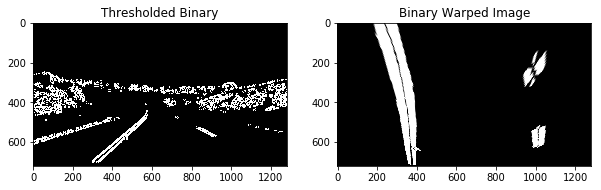

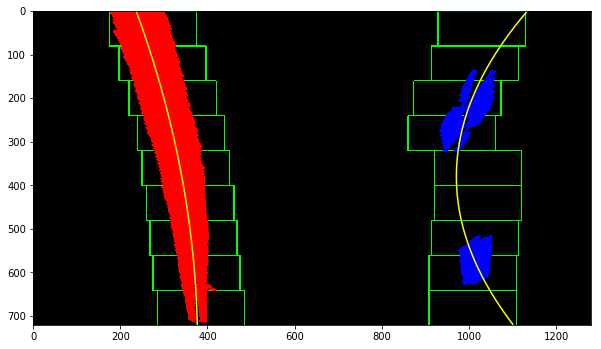

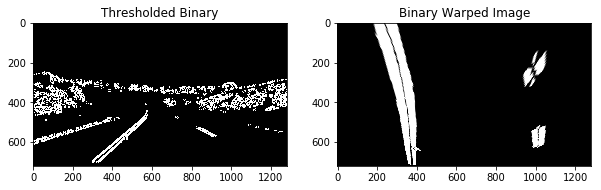

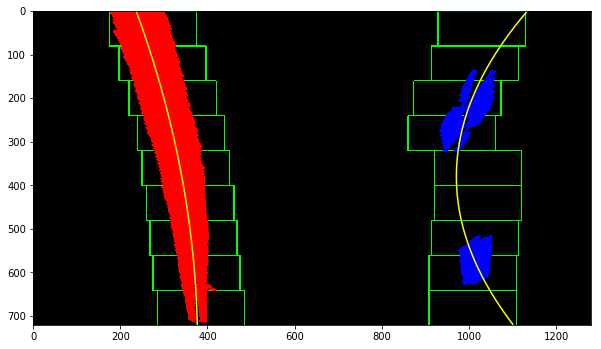

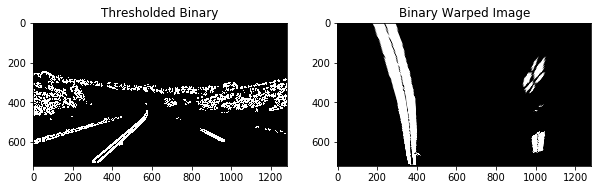

...

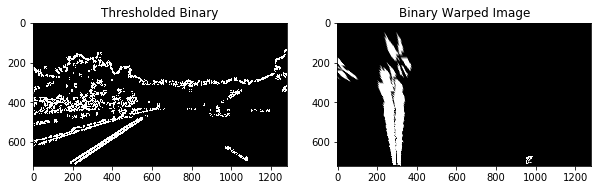

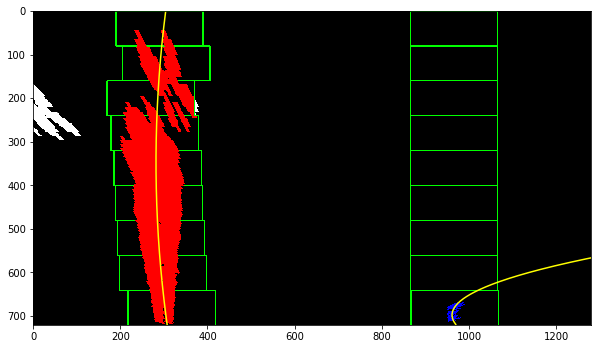

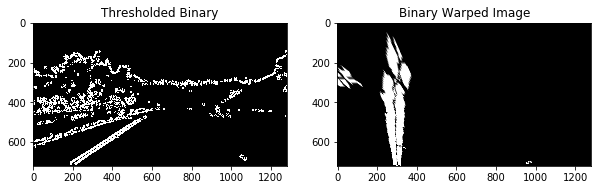

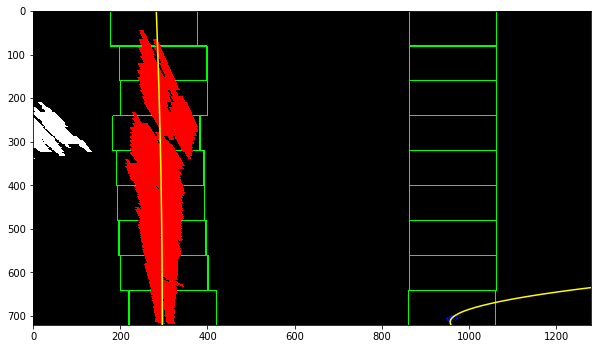

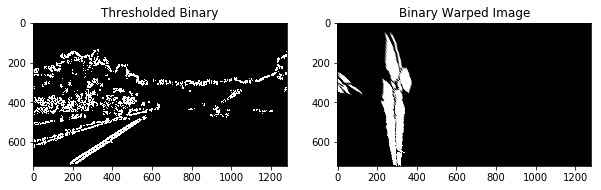

In [112]:
from moviepy.editor import VideoFileClip
from IPython.display import HTML
line_left = Line()
line_right = Line()
white_output = 'project_video_output.mp4'
clip1 = VideoFileClip("./project_video.mp4")
white_clip = clip1.fl_image(video_pipeline)
%time white_clip.write_videofile(white_output, audio=False)